Initialise  

In [1]:
import numpy as np
import pandas as pd
from statsmodels.tsa.stattools import adfuller
from sklearn.model_selection import train_test_split
from matplotlib import pyplot as plt
import glob
import re
from datetime import datetime

Import Data

In [2]:
data_read = pd.read_csv('data_min_total.csv')
data_read['DateTime_Minute'] = pd.to_datetime(data_read['DateTime_Minute'], format='%Y-%m-%d %H:%M:%S')
# Jan to May (Train)
data = data_read[data_read['DateTime_Minute'] <= '2025-05-31'].copy()

Get a df with just time and mid-price

In [3]:
arima_df = pd.DataFrame()
arima_df['Mid-Price'] = data['Mid-Price']
arima_df['Bid-Ask Spread'] = data['Bid_Ask_Spread']
arima_df.set_index(data.index, inplace=True)
arima_df.reset_index(drop=True, inplace=True)

print(type(arima_df))
print(arima_df.to_string(index=True, header=True))

#arima_df.to_csv('ARIMA Input.csv')

<class 'pandas.core.frame.DataFrame'>
       Mid-Price  Bid-Ask Spread
0         265.93            8.17
1         261.32            5.29
2         265.43            4.65
3         265.11            4.18
4         265.93            5.50
5         263.16            4.69
6         261.39            7.49
7         263.18            4.68
8         264.03            6.36
9         264.86            5.02
10        268.02            5.25
11        266.13            4.82
12        264.37            6.95
13        259.69            6.82
14        258.15            6.46
15        281.05           37.03
16        266.19           13.65
17        281.52           37.95
18        269.36           16.08
19        269.27           15.30
20        268.90           12.44
21        266.35           19.76
22        261.89            9.90
23        281.07           35.99
24        268.60           20.20
25        284.15           42.44
26        265.12           12.29
27        260.89            5.53
28   

Print Mid-Price

52512    148.76
52513    134.32
52514    140.71
52515    142.66
52516    138.15
Name: Mid-Price, dtype: float64


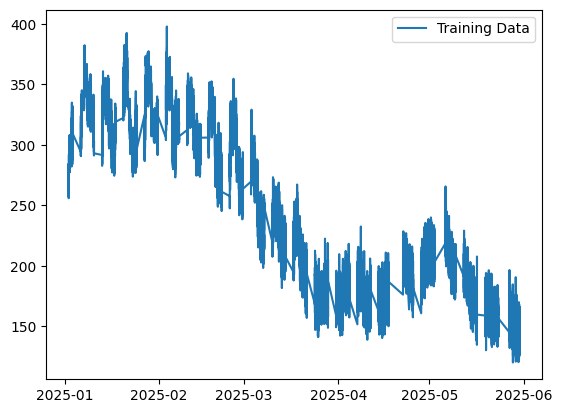

In [4]:
train_mid = (arima_df['Mid-Price'])
print(train_mid.tail())
plt.plot(data['DateTime_Minute'], data['Mid-Price'], label = 'Training Data')
plt.legend()
plt.show()


Mid-Price ADF Test to check if data is stationary 

In [5]:
#Ho: non stationary
#H1: stationary
def adfuller_test(train_mid):
    result=adfuller(train_mid)
    labels = ['ADF Test Statistic','p-value','#Lags Used','Number of Observations Used']
    for value,label in zip(result,labels):
        print(label+' : '+str(value) )
    if result[1] <= 0.05:
        print("strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data has no unit root and is stationary")
    else:
        print("weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary ")

adfuller_test(train_mid)

ADF Test Statistic : -0.993094534801097
p-value : 0.7557745709854997
#Lags Used : 46
Number of Observations Used : 52470
weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 


Bid-Ask ADF Test to check if data is stationary 

In [6]:
train_bid = arima_df['Bid-Ask Spread']
#Ho: non stationary
#H1: stationary
def adfuller_test(train_bid):
    result=adfuller(train_bid)
    labels = ['ADF Test Statistic','p-value','#Lags Used','Number of Observations Used']
    for value,label in zip(result,labels):
        print(label+' : '+str(value) )
    if result[1] <= 0.05:
        print("strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data has no unit root and is stationary")
    else:
        print("weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary ")

adfuller_test(train_bid)

ADF Test Statistic : -5.687122880267856
p-value : 8.230320777897515e-07
#Lags Used : 58
Number of Observations Used : 52458
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data has no unit root and is stationary


Mid-Price - Plot ACF

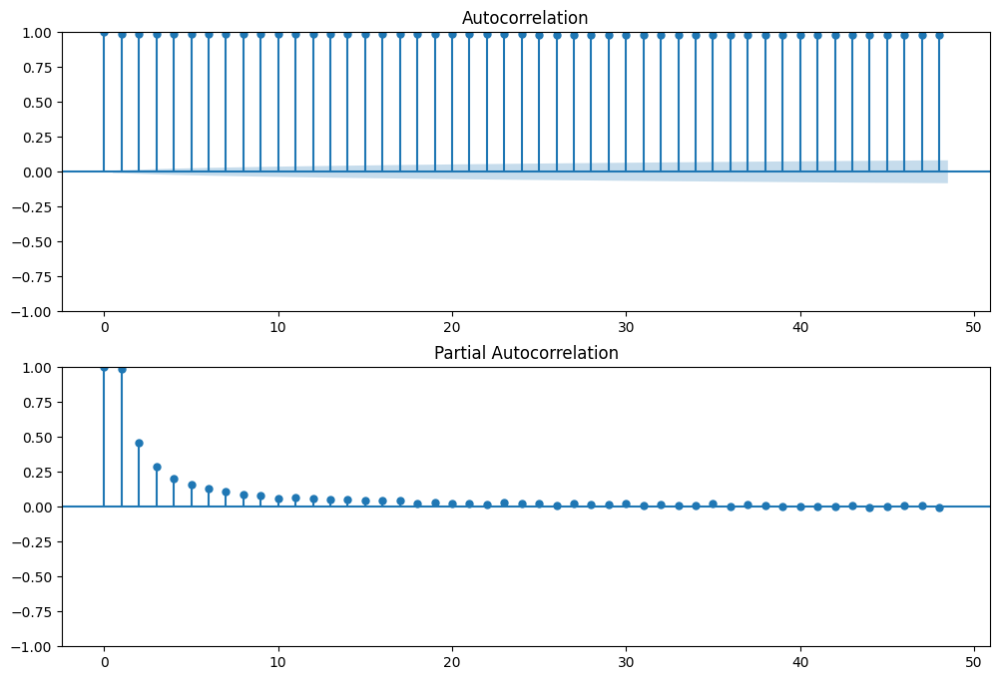

In [7]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

fig, ax = plt.subplots(2, 1, figsize=(12, 8))
plot_acf(arima_df['Mid-Price'], ax=ax[0])  # ACF plot for 'Mid-Price'
plot_pacf(arima_df['Mid-Price'], ax=ax[1])  # PACF plot for 'Mid-Price'

plt.show()

Mid-Price pdarima package to check d calc

In [8]:
from pmdarima.arima.utils import ndiffs 
ndiffs(train_mid, test = "adf")
ndiffs(train_bid, test = "adf")

0

First differencing then redo ADF

In [9]:
arima_df['Mid-Price First Difference'] = arima_df['Mid-Price'].diff()
arima_df = arima_df.dropna(subset=['Mid-Price First Difference'])
mid_price_diff = arima_df['Mid-Price First Difference']

#Ho: It is non stationary
#H1: It is stationary
def adfuller_test(mid_price_diff):
    result=adfuller(mid_price_diff)
    labels = ['ADF Test Statistic','p-value','#Lags Used','Number of Observations Used']
    for value,label in zip(result,labels):
        print(label+' : '+str(value) )
    if result[1] <= 0.05:
        print("strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data has no unit root and is stationary")
    else:
        print("weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary ")

adfuller_test(mid_price_diff)

ADF Test Statistic : -47.07756910711897
p-value : 0.0
#Lags Used : 45
Number of Observations Used : 52470
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data has no unit root and is stationary


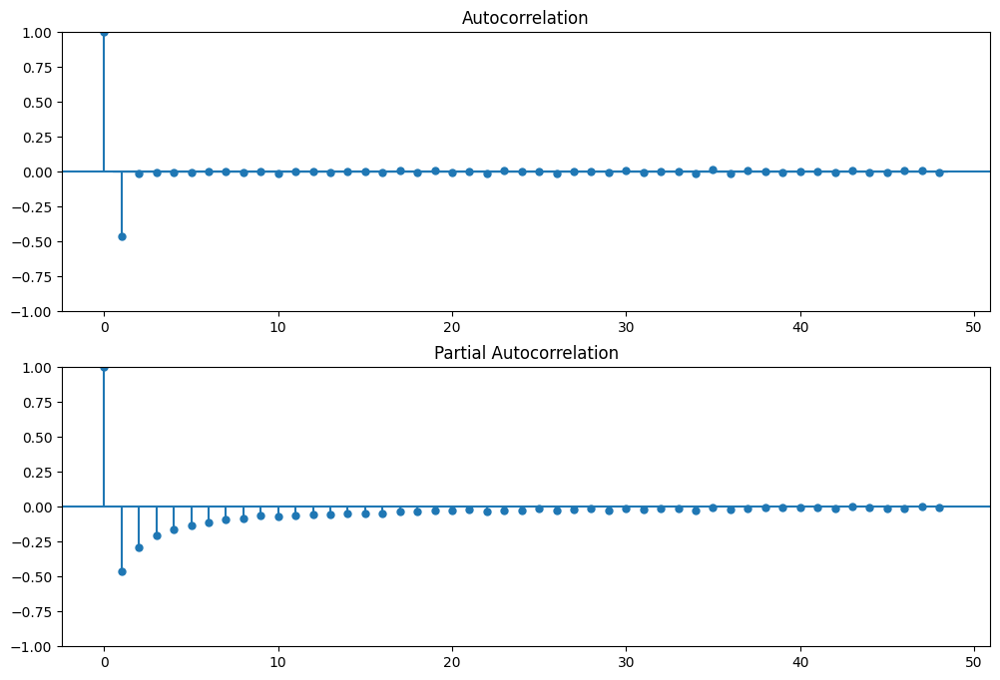

In [10]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

fig, ax = plt.subplots(2, 1, figsize=(12, 8))
plot_acf(mid_price_diff, ax=ax[0])  # ACF plot for 'Mid-Price'
plot_pacf(mid_price_diff, ax=ax[1])  # PACF plot for 'Mid-Price'

plt.show()

Bid-Ask Spread - Plot ACF

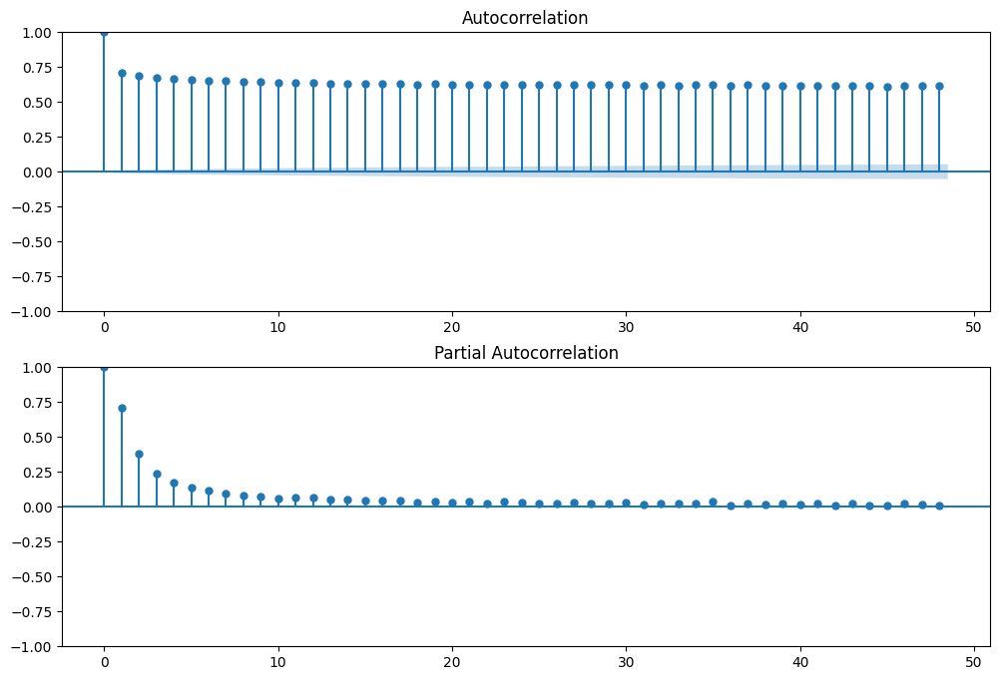

In [11]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

fig, ax = plt.subplots(2, 1, figsize=(12, 8))
plot_acf(arima_df['Bid-Ask Spread'], ax=ax[0]) 
plot_pacf(arima_df['Bid-Ask Spread'], ax=ax[1]) 

plt.show()

Plot interpretation
Mid-Price
ACF Plot Interpretation:

The ACF plot tails off gradually, which indicates that the data may be either an AR process or a mixed ARMA process. In an ACF plot for a pure MA process, we would expect a sharp cut-off after the significant lags. Therefore p = 1.

PACF Plot Interpretation:

The PACF plot shows a significant spike at lag 1, and then it almost immediately cuts off (becomes insignificant). Given the lack of significant spikes in the ACF plot beyond the immediate lag, I will start with q=0 and test q=1 as well.

Differencing Term (d):

As per the ADF test, the data is non-stationary so d = 1


Plot interpretation
Bid-Ask
ACF Plot Interpretation:

The ACF plot tails off gradually, which indicates that the data may be either an AR process or a mixed ARMA process. In an ACF plot for a pure MA process, we would expect a sharp cut-off after the significant lags. Therefore p = 1.

PACF Plot Interpretation:

The PACF plot shows a significant spike at lag 1, and then it almost immediately cuts off (becomes insignificant). Given the lack of significant spikes in the ACF plot beyond the immediate lag, I will start with q=0 and test q=3 as well.

Differencing Term (d):

As per the ADF test, the data is stationary so d = 0

Mid-Price Auto-ARIMA

In [12]:
from pmdarima import auto_arima
from statsmodels.tsa.arima.model import ARIMA

# p and d stay at 1, optimise q
auto_model = auto_arima(train_mid, 
                        start_p=1, max_p=1,   
                        d=1, max_d=1,       
                        start_q=0, max_q=5, 
                        seasonal=False, 
                        trace=True,
                        error_action='ignore',  
                        suppress_warnings=True)

# print best model
print(auto_model.summary())
# extract the best order
best_order_mid = auto_model.order
print("Best ARIMA order:", best_order_mid)

Performing stepwise search to minimize aic
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=380129.022, Time=0.97 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=392728.561, Time=0.73 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=368494.294, Time=5.10 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=392726.564, Time=0.38 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=367938.876, Time=6.69 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=367644.169, Time=26.23 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=368016.139, Time=6.84 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=367643.356, Time=41.43 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=367821.110, Time=11.04 sec
 ARIMA(1,1,4)(0,0,0)[0] intercept   : AIC=inf, Time=24.00 sec
 ARIMA(0,1,4)(0,0,0)[0] intercept   : AIC=367740.078, Time=16.27 sec
 ARIMA(1,1,3)(0,0,0)[0]             : AIC=367641.882, Time=15.80 sec
 ARIMA(0,1,3)(0,0,0)[0]             : AIC=367819.474, Time=4.28 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=367642.686, Time=10.92 sec
 ARIM

Bid-Ask Spread Auto-ARIMA

In [13]:
from pmdarima import auto_arima
from statsmodels.tsa.arima.model import ARIMA

# p and d stay at 1, optimise q
auto_model = auto_arima(train_bid, 
                        start_p=1, max_p=1,   
                        d=1, max_d=1,       
                        start_q=0, max_q=5, 
                        seasonal=False, 
                        trace=True,
                        error_action='ignore',  
                        suppress_warnings=True)

# print best model
print(auto_model.summary())
# extract the best order
best_order_bid = auto_model.order
print("Best ARIMA order:", best_order_bid)

Performing stepwise search to minimize aic
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=439970.778, Time=2.10 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=453332.069, Time=0.73 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=428090.368, Time=4.34 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=453330.069, Time=0.38 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=427419.447, Time=10.34 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=426641.781, Time=35.25 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=427556.667, Time=7.89 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=426643.113, Time=48.81 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=427151.058, Time=14.19 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=426639.906, Time=10.58 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=427554.691, Time=3.16 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=427417.479, Time=3.73 sec
 ARIMA(1,1,3)(0,0,0)[0]             : AIC=426641.237, Time=14.50 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=428088.381, Time=1.75 sec

Get test data

In [14]:
test_data = data_read[(data_read['DateTime_Minute'] >= '2025-06-01') & (data_read['DateTime_Minute'] < '2025-07-01')].copy()
arima_test_df = pd.DataFrame()
arima_test_df['Mid-Price'] = test_data['Mid-Price']
arima_test_df['Bid_Ask_Spread'] = test_data['Bid_Ask_Spread']
arima_test_df['Date'] = pd.to_datetime(test_data['DateTime_Minute'])
arima_test_df.set_index('Date', inplace=True)
#arima_test_df.head(20)

In [15]:
test_mid = arima_test_df['Mid-Price']
test_mid.index = pd.to_datetime(test_data['DateTime_Minute'])
test_bid = arima_test_df['Bid_Ask_Spread']

test_mid.head(20)
print(len(test_mid))
print(best_order_mid)

10710
(1, 1, 3)


In [16]:
horizon = 5  # predic the next 5 steps
training_window = 20  # look back window

predictions_test_mid = []
actuals_test_mid = []
forecast_means = [] 

for end in range(training_window, len(test_mid) - horizon + 1):
    test_set_mid = test_mid.iloc[end - training_window:end]
    model = ARIMA(test_set_mid, order=(1,1,3))
    model_fit = model.fit()
    forecast_test_mid = model_fit.forecast(steps=horizon)
    predictions_test_mid.extend(forecast_test_mid)
    actuals_test_mid.extend(arima_test_df['Mid-Price'].iloc[end:end + horizon])
    
    # get means
    forecast_mean = forecast_test_mid.mean()
    forecast_means.append(forecast_mean)

C:\Users\Tim\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency min will be used.
  self._init_dates(dates, freq)
C:\Users\Tim\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency min will be used.
  self._init_dates(dates, freq)
C:\Users\Tim\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency min will be used.
  self._init_dates(dates, freq)
C:\Users\Tim\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache

In [54]:
from sklearn.metrics import mean_squared_error, r2_score

predictions_test_mid = np.array(predictions_test_mid)
actuals_test_mid = np.array(actuals_test_mid)

# MSE
mse = mean_squared_error(actuals_test_mid, predictions_test_mid)

# MAPE
mape = np.mean(np.abs((actuals_test_mid - predictions_test_mid) / actuals_test_mid)) * 100

# R-squared score
r_squared = r2_score(actuals_test_mid, predictions_test_mid)

print("Mean Squared Error (MSE):", mse)
print("Mean Absolute Percentage Error (MAPE):", mape)
print("R-squared Score:", r_squared)

Mean Squared Error (MSE): 90.6595639678553
Mean Absolute Percentage Error (MAPE): 5.382383038406468
R-squared Score: -0.20263699272805225


In [72]:
from sklearn.preprocessing import StandardScaler

# Assuming predictions_test_mid and actuals_test_mid are your lists or arrays of predictions and actual values
predictions_test_mid = np.array(predictions_test_mid).reshape(-1, 1)
actuals_test_mid = np.array(actuals_test_mid).reshape(-1, 1)

# Initialize the scaler
scaler = StandardScaler()

# Fit the scaler to the actuals and transform both actuals and predictions
scaler.fit(actuals_test_mid)  # Fit only on actuals to mimic real-world scenario where predictions are unseen
actuals_test_mid_scaled = scaler.transform(actuals_test_mid)
predictions_test_mid_scaled = scaler.transform(predictions_test_mid)

# MSE
mse = mean_squared_error(actuals_test_mid_scaled, predictions_test_mid_scaled)

# MAPE - need to transform back to original scale to make percentage error meaningful
actuals_test_mid_inv = scaler.inverse_transform(actuals_test_mid_scaled)
predictions_test_mid_inv = scaler.inverse_transform(predictions_test_mid_scaled)
mape = np.mean(np.abs((actuals_test_mid_inv - predictions_test_mid_inv) / actuals_test_mid_inv)) * 100

# R-squared score
r_squared = r2_score(actuals_test_mid_scaled, predictions_test_mid_scaled)

print("Mean Squared Error (MSE):", mse)
print("Mean Absolute Percentage Error (MAPE):", mape)
print("R-squared Score:", r_squared)

Mean Squared Error (MSE): 1.2026369927280525
Mean Absolute Percentage Error (MAPE): 5.382383038406468
R-squared Score: -0.20263699272805247


In [17]:
horizon = 5  # predict the next 5 steps
training_window = 20  # look back window

predictions_test_bid = []
actuals_test_bid = []
forecast_means_bid = []

for end in range(training_window, len(test_bid) - horizon + 1):
    test_set_bid = test_bid.iloc[end - training_window:end]
    model = ARIMA(test_set_bid, order=(1,1,2)) 
    model_fit = model.fit()
    forecast_test_bid = model_fit.forecast(steps=horizon)
    predictions_test_bid.extend(forecast_test_bid)  
    actuals_test_bid.extend(arima_test_df['Bid_Ask_Spread'].iloc[end:end + horizon])
    forecast_mean_bid = forecast_test_bid.mean()
    forecast_means_bid.append(forecast_mean_bid)

C:\Users\Tim\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency min will be used.
  self._init_dates(dates, freq)
C:\Users\Tim\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency min will be used.
  self._init_dates(dates, freq)
C:\Users\Tim\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency min will be used.
  self._init_dates(dates, freq)
C:\Users\Tim\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache

C:\Users\Tim\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency min will be used.
  self._init_dates(dates, freq)
C:\Users\Tim\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency min will be used.
  self._init_dates(dates, freq)
C:\Users\Tim\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency min will be used.
  self._init_dates(dates, freq)
C:\Users\Tim\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache

In [55]:
from sklearn.metrics import mean_squared_error, r2_score

predictions_test_bid = np.array(predictions_test_bid)
actuals_test_bid = np.array(actuals_test_bid)

# MSE
mse = mean_squared_error(actuals_test_bid, predictions_test_bid)

# MAPE
mape = np.mean(np.abs((actuals_test_bid - predictions_test_bid) / actuals_test_bid)) * 100

# R-squared score
r_squared = r2_score(actuals_test_bid, predictions_test_bid)

print("Mean Squared Error (MSE):", mse)
print("Mean Absolute Percentage Error (MAPE):", mape)
print("R-squared Score:", r_squared)

Mean Squared Error (MSE): 322.98368421983406
Mean Absolute Percentage Error (MAPE): 30.492034348901324
R-squared Score: -0.21790272182206727


In [18]:
data_read = pd.read_csv('data_min_total.csv')
data_read['DateTime_Minute'] = pd.to_datetime(data_read['DateTime_Minute'], format='%Y-%m-%d %H:%M:%S')
# Jan to May (Train)
#data = data_read[data_read['DateTime_Minute'] <= '2025-05-31'].copy()
# June (Test)
data_test = data_read[(data_read['DateTime_Minute'] >= '2025-06-01') & (data_read['DateTime_Minute'] < '2025-07-01')].copy()
data_test.reset_index(inplace=True, drop=True)

In [19]:
real_mid = data_test['Mid-Price']
real_bid = data_test['Bid_Ask_Spread']
adjusted_mid = real_mid.iloc[training_window - 1:len(real_mid) - horizon]
adjusted_bid = real_bid.iloc[training_window - 1:len(real_bid) - horizon]

In [20]:
print(len(forecast_means))
print(len(adjusted_mid))
print(len(forecast_means_bid)) 
print(len(adjusted_bid))

10686
10686
10686
10686


Mid-Price Train Prediction

In [41]:
arima_df = pd.DataFrame({
    'ARIMA Forecast Average Mid-Price': forecast_means,
    'Actual Mid-Price': adjusted_mid,
    'ARIMA Forecast Average Bid-Ask Spread': forecast_means_bid,
    'Actual Bid-Ask Spread': adjusted_bid
})
arima_df.to_csv('ARIMA Trade Simulation Input.csv', index=False)

arima_df.head(20)

,ARIMA Forecast Average Mid-Price,Actual Mid-Price,ARIMA Forecast Average Bid-Ask Spread,Actual Bid-Ask Spread
19,140.546545,146.31,53.938727,64.35
20,140.392372,137.68,55.025352,48.74
21,140.510444,138.37,53.862865,50.56
22,142.149525,162.37,57.189432,98.19
23,142.340953,149.63,57.140194,70.88
24,139.589699,126.99,54.770183,26.43
25,143.567232,142.00,55.402626,60.12
26,140.108866,138.39,52.883898,51.01
27,140.634629,143.54,58.367465,62.48
28,144.095584,160.75,62.288059,93.71


In [42]:
def calculate_sortino_ratio(daily_returns, risk_free_rate=0.01):
    negative_returns = daily_returns[daily_returns < 0]
    downside_deviation = np.std(negative_returns, ddof=1)
    excess_daily_returns = daily_returns - risk_free_rate / 365
    sortino_ratio = np.mean(excess_daily_returns) / downside_deviation
    return sortino_ratio * np.sqrt(252)  # annualised

def calculate_sharpe_ratio(daily_returns, risk_free_rate=0.01):
    excess_daily_returns = daily_returns - risk_free_rate / 365
    sharpe_ratio = np.mean(excess_daily_returns) / np.std(excess_daily_returns, ddof=1)
    return sharpe_ratio * np.sqrt(252)  # annualised

def calculate_maximum_drawdown(cumulative_returns):
    cumulative_returns = np.array(cumulative_returns) + 1
    if len(cumulative_returns) > 0:
        running_max = np.maximum.accumulate(cumulative_returns)
        drawdowns = (running_max - cumulative_returns) / running_max
        max_drawdown = np.max(drawdowns)
        return max_drawdown
    else:
        return 0

def calculate_calmar_ratio(annual_return, max_drawdown):
    # if max_drawdown is negative, make it positive for the ratio
    return annual_return / abs(max_drawdown)

In [43]:
def run_trading_simulation(future_buy_increase, future_sell_decrease, quantile_optimised):
    # initial conditions
    initial_cash = 10000  # starting cash
    cash = initial_cash
    shares_owned = 0  # starting shares owned
    transactions_arima = []  # list to record transactions_arima
    daily_portfolio_values = []  # track daily portfolio values
    buy_signals = 0
    sell_signals = 0

    # parameters for market impact, slippage, and fees
    market_impact_constant = 0.1
    average_daily_volume = arima_df['Actual Mid-Price'].count()  # Using total count as a proxy
    brokerage_fee_bps = 0.005
    exchange_fee_per_share = 0.003
    shares_per_transaction = 100

    look_ahead_window = 5 
    look_back_window = 20
  
    for i in range(look_back_window, len(arima_df) - look_ahead_window):
        # Mid_price
        current_mid_price = arima_df.iloc[i]['Actual Mid-Price']
        future_avg_price = arima_df.iloc[i]['ARIMA Forecast Average Mid-Price']

        # Bid_ask_spread      
        bid_ask_spread_threshold = arima_df.iloc[i-look_back_window:i]['Actual Bid-Ask Spread'].quantile(quantile_optimised)
        future_bid_ask_avg = arima_df.iloc[i]['ARIMA Forecast Average Bid-Ask Spread']
        is_liquid = future_bid_ask_avg <= bid_ask_spread_threshold

        if future_avg_price > current_mid_price * future_buy_increase and is_liquid and cash > 0:
            # Buy condition
            shares_to_buy = min(shares_per_transaction, int(cash / (current_mid_price + brokerage_fee_bps * current_mid_price + exchange_fee_per_share)))
            volume_ratio = (shares_to_buy) / average_daily_volume
            price_impact = market_impact_constant * (volume_ratio ** 0.5) * current_mid_price
            adjusted_buy_price = current_mid_price + price_impact
            total_cost = adjusted_buy_price * shares_to_buy + brokerage_fee_bps * adjusted_buy_price * shares_to_buy + exchange_fee_per_share * shares_to_buy
            cash -= total_cost
            shares_owned += shares_to_buy
            transactions_arima.append(('Buy', shares_to_buy, adjusted_buy_price, total_cost, cash, i))
            buy_signals += 1

        elif future_avg_price < current_mid_price * future_sell_decrease and is_liquid and shares_owned > 0:
            # Sell condition
            shares_to_sell = min(shares_per_transaction, shares_owned)
            volume_ratio = shares_to_sell / average_daily_volume
            price_impact = market_impact_constant * (volume_ratio ** 0.5) * current_mid_price
            adjusted_sell_price = current_mid_price - price_impact
            total_revenue = adjusted_sell_price * shares_to_sell - brokerage_fee_bps * adjusted_sell_price * shares_to_sell - exchange_fee_per_share * shares_to_sell
            cash += total_revenue
            transactions_arima.append(('Sell', shares_to_sell, adjusted_sell_price, total_revenue, cash, i))
            shares_owned = 0
            sell_signals += 1

        # Hold condition
        else: 
            transactions_arima.append(('Hold', shares_owned, current_mid_price, 0, cash, i))

        # update portfolio value for each day
        portfolio_value = cash + shares_owned * current_mid_price
        daily_portfolio_values.append(portfolio_value)
    
    # Performance Metrics
    daily_returns = pd.Series(daily_portfolio_values).pct_change().dropna() # daily returns from portfolio values
    sortino_ratio = calculate_sortino_ratio(daily_returns)
    sharpe_ratio = calculate_sharpe_ratio(daily_returns)
    cumulative_returns = (1 + daily_returns).cumprod() - 1
    max_drawdown = calculate_maximum_drawdown(cumulative_returns)
    if len(arima_df) > 0 and (cumulative_returns.iloc[-1] + 1) > 0:
        annual_return = (cumulative_returns.iloc[-1] + 1) ** (365 / len(arima_df)) - 1
    else:
        # cases where annual return cannot be computed
        annual_return = None
    calmar_ratio = calculate_calmar_ratio(annual_return, max_drawdown)
    
    # return the overall profit or loss for simulation
    final_valuation = cash + shares_owned * arima_df.iloc[-1]['Actual Mid-Price']
    return initial_cash, final_valuation, final_valuation - initial_cash, transactions_arima, buy_signals, sell_signals, sortino_ratio, sharpe_ratio, max_drawdown, calmar_ratio, daily_returns

# optimised parameters
future_buy_increase = 1.01
future_sell_decrease = 0.97
quantile_optimised = 0.85

# Run simulation
results = []
initial_cash, final_valuation, profit_loss, transactions_arima, buy_signals, sell_signals, sortino_ratio, sharpe_ratio, max_drawdown, calmar_ratio, daily_returns = run_trading_simulation(future_buy_increase, future_sell_decrease, quantile_optimised)

# trading signal 'Hold' as default
arima_df['ARIMA Trading Signal'] = 'Hold'
# update df with transactions_arima
for transaction in transactions_arima:
    signal_type, shares, price, cost, cash, day_index = transaction
    arima_df.at[day_index, 'ARIMA Trading Signal'] = signal_type

# append results to a list
results.append((future_buy_increase, future_sell_decrease, quantile_optimised, profit_loss, len(transactions_arima), buy_signals, sell_signals, sortino_ratio, sharpe_ratio, max_drawdown, calmar_ratio))

# output results
results_df = pd.DataFrame(results, columns=['Future Buy Increase', 'Future Sell Decrease', 'Bid Ask Spread Threshold', 'Profit/Loss', 'Number of Transactions', 'Number of Buy Signals', 'Number of Sell Signals', 'Sortino Ratio', 'Sharpe Ratio', 'Max Drawdown', 'Calmar Ratio'])
results_df.to_csv('ARIMA June Trading Simulation Results.csv')

# output arima_df with signals
arima_df.to_csv('ARIMA June Data with Trading Signals.csv') 

results_df.head(50)


,Future Buy Increase,Future Sell Decrease,Bid Ask Spread Threshold,Profit/Loss,Number of Transactions,Number of Buy Signals,Number of Sell Signals,Sortino Ratio,Sharpe Ratio,Max Drawdown,Calmar Ratio
0,1.01,0.97,0.85,6814.799371,10661,4433,1881,0.615158,0.467408,0.548723,0.031469


In [58]:
from sklearn.metrics import f1_score
signals = pd.read_csv("June Data with Trading Signals.csv")
arima_df['True Trading Signals'] = signals['Trading Signal']
arima_df['Correct Prediction'] = arima_df['ARIMA Trading Signal'] == arima_df['True Trading Signals']
accuracy = arima_df['Correct Prediction'].mean()
print(f"Accuracy of ARIMA Trading Signals: {accuracy * 100:.2f}%")
f1 = f1_score(arima_df['True Trading Signals'], arima_df['ARIMA Trading Signal'], average='macro') 
print(f"F1 Score of ARIMA Trading Signals: {f1:.2f}")

Accuracy of ARIMA Trading Signals: 36.16%
F1 Score of ARIMA Trading Signals: 0.30


In [27]:
arima_df.to_csv('ARIMA Trading Simulation Results.csv')

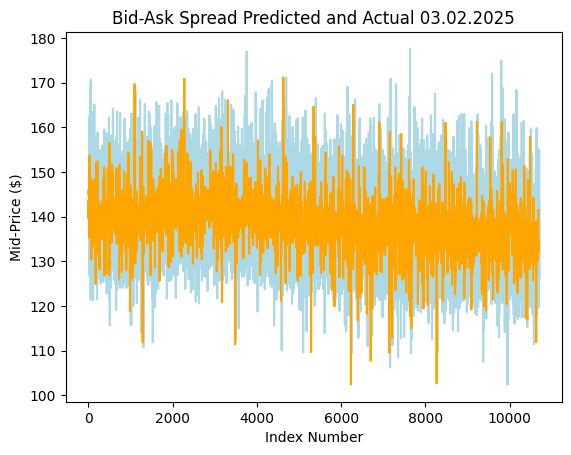

In [56]:
plt.plot(adjusted_mid, color = 'lightblue', label = 'Actual')
plt.plot(forecast_means, color = 'orange', label = 'Predicted')
plt.title('Bid-Ask Spread Predicted and Actual 03.02.2025')
plt.xlabel('Index Number')
plt.ylabel('Mid-Price ($)')
plt.show()

Make df

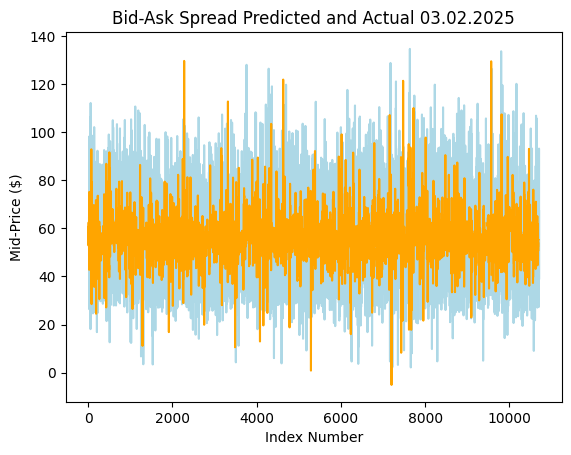

In [29]:
plt.plot(adjusted_bid, color = 'lightblue', label = 'Actual')
plt.plot(forecast_means_bid, color = 'orange', label = 'Predicted')
plt.title('Bid-Ask Spread Predicted and Actual 03.02.2025')
plt.xlabel('Index Number')
plt.ylabel('Mid-Price ($)')
plt.show()

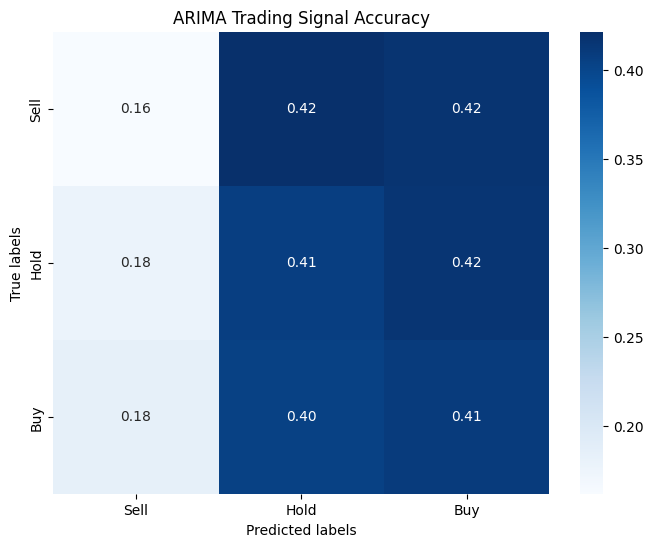

In [30]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

y_true = arima_df['True Trading Signals'].astype(str)
y_pred = arima_df['ARIMA Trading Signal'].astype(str)

labels = ['Sell', 'Hold', 'Buy']

cm = confusion_matrix(y_true, y_pred, labels=labels)

cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

# Plotting
fig, ax = plt.subplots(figsize=(8, 6))
sns.heatmap(cm_normalized, annot=True, ax=ax, cmap="Blues", fmt=".2f")
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('ARIMA Trading Signal Accuracy')
ax.xaxis.set_ticklabels(labels)
ax.yaxis.set_ticklabels(labels)

plt.show()

In [67]:
arima_df_b = arima_df
real_rsi = data_test['RSI']
adjusted_rsi= real_mid.iloc[training_window - 1:len(real_mid) - horizon]
arima_df_b['RSI'] = adjusted_rsi
arima_df_b = arima_df_b.drop(columns=arima_df_b.columns[4])
arima_df_b = arima_df_b.drop(columns=arima_df_b.columns[-1])

arima_df_b.head(20)

,ARIMA Forecast Average Mid-Price,Actual Mid-Price,ARIMA Forecast Average Bid-Ask Spread,Actual Bid-Ask Spread,RSI,True Trading Signals
19,140.546545,146.31,53.938727,64.35,146.31,Hold
20,140.392372,137.68,55.025352,48.74,137.68,Buy
21,140.510444,138.37,53.862865,50.56,138.37,Hold
22,142.149525,162.37,57.189432,98.19,162.37,Sell
23,142.340953,149.63,57.140194,70.88,149.63,Hold
24,139.589699,126.99,54.770183,26.43,126.99,Buy
25,143.567232,142.00,55.402626,60.12,142.00,Hold
26,140.108866,138.39,52.883898,51.01,138.39,Hold
27,140.634629,143.54,58.367465,62.48,143.54,Hold
28,144.095584,160.75,62.288059,93.71,160.75,Sell


In [68]:
def run_trading_simulation(future_buy_increase, future_sell_decrease, quantile_optimised):
    # Initial conditions
    initial_cash = 10000  # Starting cash
    cash = initial_cash
    shares_owned = 0  # Starting shares owned
    transactions_test = []  # List to record transactions_test
    daily_portfolio_values = []  # Track daily portfolio values for performance metrics calculation
    buy_signals = 0
    sell_signals = 0

    # Parameters for market impact, slippage, and fees
    market_impact_constant = 0.1
    total_entries = arima_df_b['Actual Mid-Price'].count()
    number_of_days = total_entries / 510
    average_daily_volume = total_entries / number_of_days  # Using total count as a proxy
    brokerage_fee_bps = 0.005
    exchange_fee_per_share = 0.003
    shares_per_transaction = 500

    look_ahead_window = 5 
    look_back_window = 20
  
    for i in range(look_back_window, len(arima_df_b) - look_ahead_window):
        # Mid_price
        current_mid_price = arima_df_b.iloc[i]['Actual Mid-Price']
        future_avg_price = arima_df_b.iloc[i]['ARIMA Forecast Average Mid-Price']
        current_RSI = arima_df_b.iloc[i]['RSI']
        # Bid_ask_spread      
        bid_ask_spread_threshold = arima_df_b.iloc[i-look_back_window:i]['Actual Bid-Ask Spread'].quantile(quantile_optimised)
        future_bid_ask_avg = arima_df_b.iloc[i]['ARIMA Forecast Average Bid-Ask Spread']
        is_liquid = future_bid_ask_avg <= bid_ask_spread_threshold

        if future_avg_price > current_mid_price * future_buy_increase and is_liquid and cash > 0 and current_RSI < buy_threshold:
            # Buy condition
            shares_to_buy = min(shares_per_transaction, int(cash / (current_mid_price + brokerage_fee_bps * current_mid_price + exchange_fee_per_share)))
            volume_ratio = (shares_to_buy) / average_daily_volume
            price_impact = market_impact_constant * (volume_ratio ** 0.5) * current_mid_price
            adjusted_buy_price = current_mid_price + price_impact
            total_cost = adjusted_buy_price * shares_to_buy + brokerage_fee_bps * adjusted_buy_price * shares_to_buy + exchange_fee_per_share * shares_to_buy
            cash -= total_cost
            shares_owned += shares_to_buy
            transactions_test.append(('Buy', shares_to_buy, adjusted_buy_price, total_cost, cash, i))
            buy_signals += 1

        elif future_avg_price < current_mid_price * future_sell_decrease and is_liquid and shares_owned > 0 and current_RSI >= sell_threshold:
            # Sell condition
            shares_to_sell = min(shares_per_transaction, shares_owned)
            volume_ratio = shares_to_sell / average_daily_volume
            price_impact = market_impact_constant * (volume_ratio ** 0.5) * current_mid_price
            adjusted_sell_price = current_mid_price - price_impact
            total_revenue = adjusted_sell_price * shares_to_sell - brokerage_fee_bps * adjusted_sell_price * shares_to_sell - exchange_fee_per_share * shares_to_sell
            cash += total_revenue
            transactions_test.append(('Sell', shares_to_sell, adjusted_sell_price, total_revenue, cash, i))
            shares_owned = 0
            sell_signals += 1

        # Hold condition
        else: 
            transactions_test.append(('Hold', shares_owned, current_mid_price, 0, cash, i))

        # Update the portfolio value for each day
        portfolio_value = cash + shares_owned * current_mid_price
        daily_portfolio_values.append(portfolio_value)
    
    # Performance Metrics
    daily_returns = pd.Series(daily_portfolio_values).pct_change().dropna() # daily returns from portfolio values
    sortino_ratio = calculate_sortino_ratio(daily_returns)
    sharpe_ratio = calculate_sharpe_ratio(daily_returns)
    cumulative_returns = (1 + daily_returns).cumprod() - 1
    max_drawdown = calculate_maximum_drawdown(cumulative_returns)
    if len(arima_df_b) > 0 and (cumulative_returns.iloc[-1] + 1) > 0:
        annual_return = (cumulative_returns.iloc[-1] + 1) ** (365 / len(arima_df_b)) - 1
    else:
        # cases where annual return cannot be computed
        annual_return = None
    calmar_ratio = calculate_calmar_ratio(annual_return, max_drawdown)
    
    # Return the overall profit or loss for this simulation run
    final_valuation = cash + shares_owned * arima_df_b.iloc[-1]['Actual Mid-Price']
    return initial_cash, final_valuation, final_valuation - initial_cash, transactions_test, buy_signals, sell_signals, sortino_ratio, sharpe_ratio, max_drawdown, calmar_ratio, daily_returns

# optimised parameters
future_buy_increase = 1.01
future_sell_decrease = 0.97
quantile_optimised = 0.85
buy_threshold = 40
sell_threshold = 60

# run simulation
results = []
initial_cash_test, final_valuation_test, profit_loss_test, transactions_test, buy_signals_test, sell_signals_test, sortino_ratio_test, sharpe_ratio_test, max_drawdown_test, calmar_ratio_test, daily_returns_test = run_trading_simulation(future_buy_increase, future_sell_decrease, quantile_optimised)

# trading signal 'Hold' as default
arima_df_b['ARIMA Trading Signal'] = 'Hold'
# update df with transactions_arima
for transaction in transactions_test:
    signal_type, shares, price, cost, cash, day_index = transaction
    arima_df_b.at[day_index, 'ARIMA Trading Signal'] = signal_type

# Append results to a list
results.append((future_buy_increase, future_sell_decrease, quantile_optimised, profit_loss_test, len(transactions_test), buy_signals_test, sell_signals_test, sortino_ratio_test, sharpe_ratio_test, max_drawdown_test, calmar_ratio_test))

# Output results
results_df_b = pd.DataFrame(results, columns=['Future Buy Increase', 'Future Sell Decrease', 'Bid Ask Spread Threshold', 'Profit/Loss', 'Number of Transactions', 'Number of Buy Signals', 'Number of Sell Signals', 'Sortino Ratio', 'Sharpe Ratio', 'Max Drawdown', 'Calmar Ratio'])
results_df_b.to_csv('ARIMA June Trading Simulation Results + RSI B.csv')

# Output data with signals
arima_df_b.to_csv('ARIMA June Data with Trading Signals + RSI B.csv') 

results_df_b.head(50)

C:\Users\Tim\AppData\Local\Temp\ipykernel_488\3044620160.py:25: RuntimeWarning: invalid value encountered in scalar divide
  return annual_return / abs(max_drawdown)


,Future Buy Increase,Future Sell Decrease,Bid Ask Spread Threshold,Profit/Loss,Number of Transactions,Number of Buy Signals,Number of Sell Signals,Sortino Ratio,Sharpe Ratio,Max Drawdown,Calmar Ratio
0,1.01,0.97,0.85,0.0,10661,0,0,NaN,-4.278637e+16,0.0,NaN


In [69]:
arima_df_b.head(20)

,ARIMA Forecast Average Mid-Price,Actual Mid-Price,ARIMA Forecast Average Bid-Ask Spread,Actual Bid-Ask Spread,RSI,True Trading Signals,ARIMA Trading Signal
19,140.546545,146.31,53.938727,64.35,146.31,Hold,Hold
20,140.392372,137.68,55.025352,48.74,137.68,Buy,Hold
21,140.510444,138.37,53.862865,50.56,138.37,Hold,Hold
22,142.149525,162.37,57.189432,98.19,162.37,Sell,Hold
23,142.340953,149.63,57.140194,70.88,149.63,Hold,Hold
24,139.589699,126.99,54.770183,26.43,126.99,Buy,Hold
25,143.567232,142.00,55.402626,60.12,142.00,Hold,Hold
26,140.108866,138.39,52.883898,51.01,138.39,Hold,Hold
27,140.634629,143.54,58.367465,62.48,143.54,Hold,Hold
28,144.095584,160.75,62.288059,93.71,160.75,Sell,Hold


In [70]:
from sklearn.metrics import f1_score
signals = pd.read_csv("June Data with Trading Signals.csv")
arima_df_b['True Trading Signals'] = signals['Trading Signal']
arima_df_b['Correct Prediction'] = arima_df_b['ARIMA Trading Signal'] == arima_df_b['True Trading Signals']
accuracy = arima_df_b['Correct Prediction'].mean()
print(f"Accuracy of ARIMA Trading Signals: {accuracy * 100:.2f}%")
f1 = f1_score(arima_df_b['True Trading Signals'], arima_df_b['ARIMA Trading Signal'], average='macro') 
print(f"F1 Score of ARIMA Trading Signals: {f1:.2f}")

Accuracy of ARIMA Trading Signals: 62.56%
F1 Score of ARIMA Trading Signals: 0.26


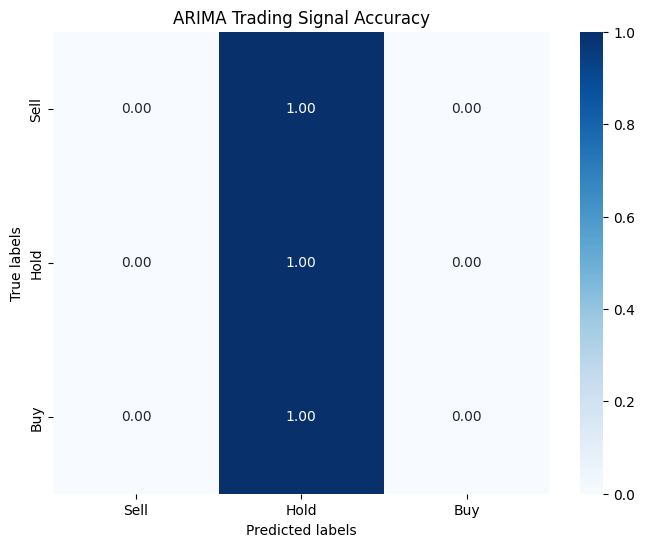

In [71]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

y_true = arima_df_b['True Trading Signals'].astype(str)
y_pred = arima_df_b['ARIMA Trading Signal'].astype(str)

labels = ['Sell', 'Hold', 'Buy']

cm = confusion_matrix(y_true, y_pred, labels=labels)

cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

# Plotting
fig, ax = plt.subplots(figsize=(8, 6))
sns.heatmap(cm_normalized, annot=True, ax=ax, cmap="Blues", fmt=".2f")
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('ARIMA Trading Signal Accuracy')
ax.xaxis.set_ticklabels(labels)
ax.yaxis.set_ticklabels(labels)

plt.show()